We will look for a relationship between the period, I band amplitude, and phi31 for RR Lyrae RRab stars using data from the OGLE IV survey. To keep the data small, we will use data from the SMC rather than the larger LMC dataset.

## Visualizing the data
First let's load in the data and do a quick visualization of it.

In [1]:
import pandas as pd

dataFile = "~/Documents/ogle/ogle4/smc/RRab.csv"
data = pd.read_csv(dataFile).dropna()

data = data.ix[:, data.columns != "id"]
data.describe()

,magnitude_Iband,magnitude_Vband,period,period_uncertainty,time_max_bright,amplitude_Iband,R21,phi21,R31,phi31
count,4748.000000,4748.000000,4748.000000,4.748000e+03,4748.000000,4748.000000,4748.000000,4748.000000,4748.000000,4748.000000
mean,18.839039,19.415382,0.596560,2.803875e-06,6000.297409,0.504458,0.419089,4.294047,0.297968,2.460209
std,0.906234,0.915491,0.057343,3.421723e-06,0.175088,0.153931,0.060421,0.189534,0.070244,0.423121
min,12.048000,12.632000,0.374290,1.000000e-07,6000.000020,0.025000,0.125000,3.206000,0.024000,0.395000
25%,18.918000,19.489000,0.561476,1.200000e-06,6000.148912,0.393000,0.382000,4.163750,0.255000,2.158000
50%,19.062000,19.637000,0.596877,2.000000e-06,6000.294415,0.497000,0.421000,4.266000,0.310000,2.403000
75%,19.182250,19.760000,0.630260,3.300000e-06,6000.442110,0.612000,0.458000,4.400000,0.351000,2.714000
max,20.419000,21.303000,0.975487,1.065000e-04,6000.920100,1.053000,0.654000,5.161000,0.589000,5.795000


In [2]:
import plotly as py
import plotly.graph_objs as go

py.offline.init_notebook_mode()

main_data = go.Scatter3d(
    x=data["period"],
    y=data["amplitude_Iband"],
    z=data["phi31"],
    mode='markers',
    marker=dict(
        size=5,
        line=dict(
            color='rgba(217, 217, 217, 0.14)',
            width=0.5
        ),
        opacity=0.8
    )
)

parts = [main_data]
layout = go.Layout(
    margin=dict(
        l=0,
        r=0,
        b=0,
        t=0
    ),
    scene=go.Scene(
        xaxis=go.XAxis(title='Period'),
        yaxis=go.YAxis(title='Amplitude I band'),
        zaxis=go.ZAxis(title='phi31')
    )
)
fig = go.Figure(data=parts, layout=layout)
py.offline.iplot(fig, filename='simple-3d-scatter')

Looking at the data, there seems to be some sort of correlation between the variables. The points seem to mainly cluster along a curved line that 3 dimensionally spans the 3 variables.

## Finding the line
Let's try to find the equation for the line that the data clusters around. First we will try applying a simple polynomial regression and take a look at the line that we get.

In [3]:
from sklearn import linear_model
from sklearn import pipeline
from sklearn import preprocessing

# Setup for the polynomial regression
d = 2
poly = preprocessing.PolynomialFeatures(degree = d, include_bias = False)
reg = linear_model.LinearRegression()
model = pipeline.Pipeline([("polynomial_features", poly), ("linear_regression", reg)])

# Perform the polynomial regression
x = data.as_matrix(["period"])
y = data.as_matrix(["amplitude_Iband", "phi31"])
model.fit(x, y)

# Determine the formulas for the line
def line_equations(model, feature_names):
    coef = model.steps[1][1].coef_
    features = model.steps[0][1].get_feature_names(feature_names)
    zero = model.steps[1][1].intercept_
    print("ampliitude_Iband = " + str(zero[0]) + " + " + str(coef[0][0]) + " * " + features[0] + " + " + str(coef[0][1]) + " * " + features[1])
    print("")
    print("phi31            = " + str(zero[1]) + " + " + str(coef[1][0]) + " * " + features[0] + " + " + str(coef[1][1]) + " * " + features[1])

# Gives score information on the line
def line_score(model, x, y):
    print("Score: " + str(model.score(x, y)))

In [4]:
import numpy as np

# Generate points along the created line in order to plot it
c = 0.25
interval = 0.001
lineX = np.arange(data["period"].min(), data["period"].max() - c, interval)
lineYZ = map(model.predict, lineX)
lineY = map(lambda r: r[0][0], lineYZ)
lineZ = map(lambda r: r[0][1], lineYZ)

In [5]:
import plotly as py
import plotly.graph_objs as go

py.offline.init_notebook_mode()

main_data = go.Scatter3d(
    x=data["period"],
    y=data["amplitude_Iband"],
    z=data["phi31"],
    mode='markers',
    marker=dict(
        size=5,
        line=dict(
            color='rgba(217, 217, 217, 0.14)',
            width=0.5
        ),
        opacity=0.8
    )
)

line_scatter = go.Scatter3d(
    x=lineX,
    y=lineY,
    z=lineZ,
    mode='markers',
    marker=dict(
        size=5,
        line=dict(
            color='rgba(217, 217, 217, 0.14)',
            width=0.5
        ),
        opacity=0.8
    )
)

parts = [main_data, line_scatter]
layout = go.Layout(
    margin=dict(
        l=0,
        r=0,
        b=0,
        t=0
    ),
    scene=go.Scene(
        xaxis=go.XAxis(title='Period'),
        yaxis=go.YAxis(title='Amplitude I band'),
        zaxis=go.ZAxis(title='phi31')
    )
)
fig = go.Figure(data=parts, layout=layout)
py.offline.iplot(fig, filename='simple-3d-scatter')

In [6]:
line_equations(model, ["period", "amplitude_Iband", "phi31"])
line_score(model, x, y)

ampliitude_Iband = 3.05982179771 + -6.79872425869 * period + 4.1776211805 * period^2

phi31            = 1.09524084494 + 0.184654212203 * period + 3.49363299753 * period^2
Score: 0.373474249868


Looking at the line created by the polynomial regression, we can see that it does not seem to fit the curved line apparent in the data. This is likely due to the presence of outliers in the data.

Let's try applying some different outlier removal techniques to see if we can get a better polynomial regression.

Before we apply any outlier removal techniques, let's normalize the data first.

In [7]:
data_norm = data.copy()
data_norm = data_norm.ix[:,["period", "amplitude_Iband", "phi31"]]
data_norm[data_norm.columns] = preprocessing.scale(data_norm)

data_norm.describe()

,period,amplitude_Iband,phi31
count,4.748000e+03,4.748000e+03,4.748000e+03
mean,3.561693e-16,8.829406e-17,-5.088132e-17
std,1.000105e+00,1.000105e+00,1.000105e+00
min,-3.876552e+00,-3.115094e+00,-4.881413e+00
25%,-6.118805e-01,-7.241538e-01,-7.143135e-01
50%,5.544384e-03,-4.845335e-02,-1.352214e-01
75%,5.877678e-01,6.987154e-01,5.998710e-01
max,6.608780e+00,3.563945e+00,7.882249e+00


### SVM
The `sklearn` library offers a class called `svm.OneClassSVM` that allows for novelty removal using a support vector machine. Let's try applying that to the data and see what it comes up with for the regression.

In [8]:
from sklearn import svm

# Train the SVM
svm_novelty = svm.OneClassSVM()
svm_novelty.fit(data_norm.as_matrix())

OneClassSVM(cache_size=200, coef0=0.0, degree=3, gamma='auto', kernel='rbf',
      max_iter=-1, nu=0.5, random_state=None, shrinking=True, tol=0.001,
      verbose=False)

In [9]:
# Find the novelty and regular data points
data["svm_pred"] = svm_novelty.predict(data_norm.as_matrix())

regular_svm = data[data["svm_pred"] == 1.0]
novelty_svm = data[data["svm_pred"] == -1.0]

The SVM indicates novelty data points using -1.0 and regular points using +1.0. Now we can perform a polynomial regression on the regular data points.

In [10]:
# Setup for the polynomial regression
d_svm = 2
poly_svm = preprocessing.PolynomialFeatures(degree = d_svm, include_bias = False)
reg_svm = linear_model.LinearRegression()
model_svm = pipeline.Pipeline([("polynomial_features", poly_svm), ("linear_regression", reg_svm)])

# Perform the polynomial regression
x_svm = regular_svm.as_matrix(["period"])
y_svm = regular_svm.as_matrix(["amplitude_Iband", "phi31"])
model_svm.fit(x_svm, y_svm)

Pipeline(steps=[('polynomial_features', PolynomialFeatures(degree=2, include_bias=False, interaction_only=False)), ('linear_regression', LinearRegression(copy_X=True, fit_intercept=True, n_jobs=1, normalize=False))])

In [11]:
# Generate points along the created line in order to plot it
c_svm = 0.25
interval_svm = 0.001
lineX_svm = np.arange(data["period"].min(), data["period"].max() - c_svm, interval_svm)
lineYZ_svm = map(model_svm.predict, lineX_svm)
lineY_svm = map(lambda r: r[0][0], lineYZ_svm)
lineZ_svm = map(lambda r: r[0][1], lineYZ_svm)

In [12]:
import plotly as py
import plotly.graph_objs as go

py.offline.init_notebook_mode()

regular = go.Scatter3d(
    x=regular_svm["period"],
    y=regular_svm["amplitude_Iband"],
    z=regular_svm["phi31"],
    mode='markers',
    marker=dict(
        size=5,
        line=dict(
            color='rgba(217, 217, 217, 0.14)',
            width=0.5
        ),
        opacity=0.8
    )
)

novelty = go.Scatter3d(
    x=novelty_svm["period"],
    y=novelty_svm["amplitude_Iband"],
    z=novelty_svm["phi31"],
    mode='markers',
    marker=dict(
        size=5,
        line=dict(
            color='rgba(217, 217, 217, 0.14)',
            width=0.5
        ),
        opacity=0.8
    )
)

line_scatter = go.Scatter3d(
    x=lineX_svm,
    y=lineY_svm,
    z=lineZ_svm,
    mode='markers',
    marker=dict(
        size=5,
        line=dict(
            color='rgba(217, 217, 217, 0.14)',
            width=0.5
        ),
        opacity=0.8
    )
)

parts = [regular, novelty, line_scatter]
layout = go.Layout(
    margin=dict(
        l=0,
        r=0,
        b=0,
        t=0
    ),
    scene=go.Scene(
        xaxis=go.XAxis(title='Period'),
        yaxis=go.YAxis(title='Amplitude I band'),
        zaxis=go.ZAxis(title='phi31')
    )
)
fig = go.Figure(data=parts, layout=layout)
py.offline.iplot(fig, filename='simple-3d-scatter')

In [13]:
line_equations(model_svm, ["period", "amplitude_Iband", "phi31"])
line_score(model_svm, x_svm, y_svm)

ampliitude_Iband = 0.810629833373 + 1.69428078568 * period + -3.69439530468 * period^2

phi31            = 7.16154037073 + -21.8652256205 * period + 23.2815672419 * period^2
Score: 0.517476641948


The line that the regression created using the regular data looks much more accurate than the line created using the raw data. However, it looks like it may be slightly off.

Looking at the regular and novelty data determined by the SVM, it looks like the algorithm may have excluded some points that may be regular. Some points that have lower phi31 and higher amplitude seem like they should be regular points rather than novelties.

Let's try applying some other outlier removal techniques to see if they offer better results.

### EllipticEnvelope
The `sklearn` library offers a class called `covariance.EllipticEnvelope` which allows for outlier detection in a Gaussian distributed dataset. Let's try applying this outlier removal technique.

In [14]:
from sklearn import covariance

# Train the EllipticEnvelope
ee_outlier = covariance.EllipticEnvelope()
ee_outlier.fit(data_norm.as_matrix())

EllipticEnvelope(assume_centered=False, contamination=0.1, random_state=None,
         store_precision=True, support_fraction=None)

In [15]:
# Find the outlier and regular data points
data["ee_pred"] = ee_outlier.predict(data_norm.as_matrix())

regular_ee = data[data["ee_pred"] == 1.0]
outlier_ee = data[data["ee_pred"] == -1.0]

In [16]:
# Setup for the polynomial regression
d_ee = 2
poly_ee = preprocessing.PolynomialFeatures(degree = d_ee, include_bias = False)
reg_ee = linear_model.LinearRegression()
model_ee = pipeline.Pipeline([("polynomial_features", poly_ee), ("linear_regression", reg_ee)])

# Perform the polynomial regression
x_ee = regular_ee.as_matrix(["period"])
y_ee = regular_ee.as_matrix(["amplitude_Iband", "phi31"])
model_ee.fit(x_ee, y_ee)

Pipeline(steps=[('polynomial_features', PolynomialFeatures(degree=2, include_bias=False, interaction_only=False)), ('linear_regression', LinearRegression(copy_X=True, fit_intercept=True, n_jobs=1, normalize=False))])

In [17]:
# Generate points along the created line in order to plot it
c_ee = 0.25
interval_ee = 0.001
lineX_ee = np.arange(data["period"].min(), data["period"].max() - c_ee, interval_ee)
lineYZ_ee = map(model_ee.predict, lineX_ee)
lineY_ee = map(lambda r: r[0][0], lineYZ_ee)
lineZ_ee = map(lambda r: r[0][1], lineYZ_ee)

In [18]:
import plotly as py
import plotly.graph_objs as go

py.offline.init_notebook_mode()

regular = go.Scatter3d(
    x=regular_ee["period"],
    y=regular_ee["amplitude_Iband"],
    z=regular_ee["phi31"],
    mode='markers',
    marker=dict(
        size=5,
        line=dict(
            color='rgba(217, 217, 217, 0.14)',
            width=0.5
        ),
        opacity=0.8
    )
)

novelty = go.Scatter3d(
    x=outlier_ee["period"],
    y=outlier_ee["amplitude_Iband"],
    z=outlier_ee["phi31"],
    mode='markers',
    marker=dict(
        size=5,
        line=dict(
            color='rgba(217, 217, 217, 0.14)',
            width=0.5
        ),
        opacity=0.8
    )
)

line_scatter = go.Scatter3d(
    x=lineX_ee,
    y=lineY_ee,
    z=lineZ_ee,
    mode='markers',
    marker=dict(
        size=5,
        line=dict(
            color='rgba(217, 217, 217, 0.14)',
            width=0.5
        ),
        opacity=0.8
    )
)

parts = [regular, novelty, line_scatter]
layout = go.Layout(
    margin=dict(
        l=0,
        r=0,
        b=0,
        t=0
    ),
    scene=go.Scene(
        xaxis=go.XAxis(title='Period'),
        yaxis=go.YAxis(title='Amplitude I band'),
        zaxis=go.ZAxis(title='phi31')
    )
)
fig = go.Figure(data=parts, layout=layout)
py.offline.iplot(fig, filename='simple-3d-scatter')

In [19]:
line_equations(model_ee, ["period", "amplitude_Iband", "phi31"])
line_score(model_ee, x_ee, y_ee)

ampliitude_Iband = 2.41564429843 + -3.85681046509 * period + 1.07381096994 * period^2

phi31            = 6.77188232243 + -20.3669567069 * period + 21.8881971531 * period^2
Score: 0.463387487034


The line created using the EllipticEnvelope outlier removal does not seem to have as good of a fit as the line created using the SVM novelty removal. The outlier removal using the EllipticEnvelope was less strict than that of the SVM, but it looks like it may have left in a few outliers.

### IsolationForest
The `sklearn` library also offers a class called `ensemble.IsolationForest` which allows for outlier removal using the IsolationForest algorithm.

In [20]:
from sklearn import ensemble

# Train the IsolationForest
isolation_forest = ensemble.IsolationForest()
isolation_forest.fit(data_norm.as_matrix())

IsolationForest(bootstrap=False, contamination=0.1, max_features=1.0,
        max_samples='auto', n_estimators=100, n_jobs=1, random_state=None,
        verbose=0)

In [21]:
# Find the outlier and regular data points
data["iso_pred"] = isolation_forest.predict(data_norm.as_matrix())

regular_iso = data[data["iso_pred"] == 1.0]
outlier_iso = data[data["iso_pred"] == -1.0]

In [22]:
# Setup for the polynomial regression
d_iso = 2
poly_iso = preprocessing.PolynomialFeatures(degree = d_iso, include_bias = False)
reg_iso = linear_model.LinearRegression()
model_iso = pipeline.Pipeline([("polynomial_features", poly_iso), ("linear_regression", reg_iso)])

# Perform the polynomial regression
x_iso = regular_iso.as_matrix(["period"])
y_iso = regular_iso.as_matrix(["amplitude_Iband", "phi31"])
model_iso.fit(x_iso, y_iso)

Pipeline(steps=[('polynomial_features', PolynomialFeatures(degree=2, include_bias=False, interaction_only=False)), ('linear_regression', LinearRegression(copy_X=True, fit_intercept=True, n_jobs=1, normalize=False))])

In [23]:
# Generate points along the created line in order to plot it
c_iso = 0.25
interval_iso = 0.001
lineX_iso = np.arange(data["period"].min(), data["period"].max() - c_iso, interval_iso)
lineYZ_iso = map(model_iso.predict, lineX_iso)
lineY_iso = map(lambda r: r[0][0], lineYZ_iso)
lineZ_iso = map(lambda r: r[0][1], lineYZ_iso)

In [24]:
import plotly as py
import plotly.graph_objs as go

py.offline.init_notebook_mode()

regular = go.Scatter3d(
    x=regular_iso["period"],
    y=regular_iso["amplitude_Iband"],
    z=regular_iso["phi31"],
    mode='markers',
    marker=dict(
        size=5,
        line=dict(
            color='rgba(217, 217, 217, 0.14)',
            width=0.5
        ),
        opacity=0.8
    )
)

novelty = go.Scatter3d(
    x=outlier_iso["period"],
    y=outlier_iso["amplitude_Iband"],
    z=outlier_iso["phi31"],
    mode='markers',
    marker=dict(
        size=5,
        line=dict(
            color='rgba(217, 217, 217, 0.14)',
            width=0.5
        ),
        opacity=0.8
    )
)

line_scatter = go.Scatter3d(
    x=lineX_iso,
    y=lineY_iso,
    z=lineZ_iso,
    mode='markers',
    marker=dict(
        size=5,
        line=dict(
            color='rgba(217, 217, 217, 0.14)',
            width=0.5
        ),
        opacity=0.8
    )
)

parts = [regular, novelty, line_scatter]
layout = go.Layout(
    margin=dict(
        l=0,
        r=0,
        b=0,
        t=0
    ),
    scene=go.Scene(
        xaxis=go.XAxis(title='Period'),
        yaxis=go.YAxis(title='Amplitude I band'),
        zaxis=go.ZAxis(title='phi31')
    )
)
fig = go.Figure(data=parts, layout=layout)
py.offline.iplot(fig, filename='simple-3d-scatter')

In [25]:
line_equations(model_iso, ["period", "amplitude_Iband", "phi31"])
line_score(model_iso, x_iso, y_iso)

ampliitude_Iband = 3.33994317827 + -7.50431559549 * period + 4.58423602725 * period^2

phi31            = 3.8402694317 + -9.58530531329 * period + 12.0747899289 * period^2
Score: 0.390249828609


The line created using the outlier removal with the IsolationForest seems to fit less than both the SVM and the EllipticEnvelope. The IsolationForest did not seem to remove many of the  ]outliers.

### Configuring Parameters
Overall it seems that the SVM seemed to remove the outliers from the data best. Let's see if we can configure the SVM a bit to improve the outlier removal, and thus the line created from it.

The SVM class constructor has a parameter `nu` that looks like it may be useful to try out. Let's try a few different settings for it and see what settings maximize the score.

0.05 -> 0.452953452642
0.1 -> 0.478222195652
0.15 -> 0.49253214762
0.2 -> 0.510093512981
0.25 -> 0.513797733202
0.3 -> 0.519494866521
0.35 -> 0.525406121745
0.4 -> 0.524637114036
0.45 -> 0.522982363208
0.5 -> 0.517476641948
0.55 -> 0.504516484072
0.6 -> 0.481418244174
0.65 -> 0.450979715813
0.7 -> 0.39851613298
0.75 -> 0.354514839207
0.8 -> 0.300639922635
0.85 -> 0.204881725805
0.9 -> 0.152034764843
0.95 -> 0.12889333922


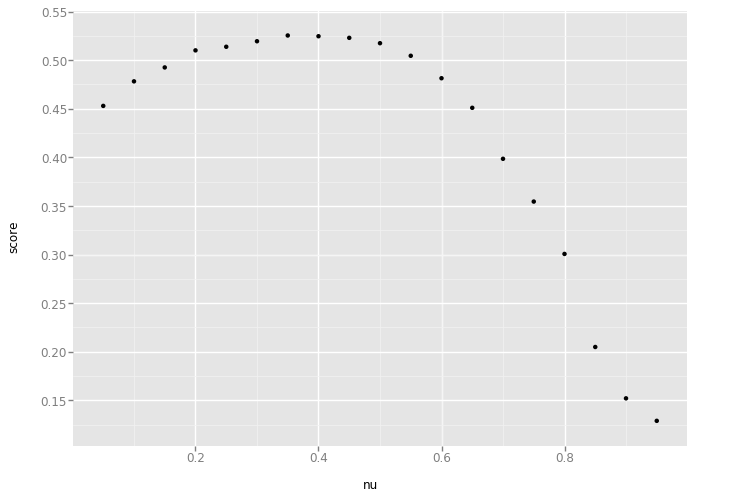

<ggplot: (8741454858033)>

In [26]:
interval = 0.05
min = 0 + interval
max = 1.0
nus = np.arange(min, max, interval)
svm_scores = []
for nu in nus:
    # Train the SVM
    svm_novelty_2 = svm.OneClassSVM(nu = nu)
    svm_novelty_2.fit(data_norm.as_matrix())

    # Find the novelty and regular data points
    data["svm_pred_2"] = svm_novelty_2.predict(data_norm.as_matrix())

    regular_svm_2 = data[data["svm_pred_2"] == 1.0]
    novelty_svm_2 = data[data["svm_pred_2"] == -1.0]

    # Setup for the polynomial regression
    d_svm_2 = 2
    poly_svm_2 = preprocessing.PolynomialFeatures(degree = d_svm_2, include_bias = False)
    reg_svm_2 = linear_model.LinearRegression()
    model_svm_2 = pipeline.Pipeline([("polynomial_features", poly_svm_2), ("linear_regression", reg_svm_2)])

    # Perform the polynomial regression
    x_svm_2 = regular_svm_2.as_matrix(["period"])
    y_svm_2 = regular_svm_2.as_matrix(["amplitude_Iband", "phi31"])
    model_svm_2.fit(x_svm_2, y_svm_2)
    
    score = model_svm_2.score(x_svm_2, y_svm_2)
    svm_scores.append(score)
    print(str(nu) + " -> " + str(score))

svm_nu_scores = pd.DataFrame(zip(nus, svm_scores), columns = ["nu", "score"])

from ggplot import *

ggplot(aes(x = "nu", y = "score"), data = svm_nu_scores) + geom_point()

In [27]:
best_nu = svm_nu_scores.sort_values("score", ascending=False).iloc[0][0]

best_nu

0.35000000000000003

Now let's take the best `nu` setting that we found and plot the line that we get when using it.

In [28]:
# Train the SVM
svm_novelty_2 = svm.OneClassSVM(nu = best_nu)
svm_novelty_2.fit(data_norm.as_matrix())

# Find the novelty and regular data points
data["svm_pred_2"] = svm_novelty_2.predict(data_norm.as_matrix())

regular_svm_2 = data[data["svm_pred_2"] == 1.0]
novelty_svm_2 = data[data["svm_pred_2"] == -1.0]

# Setup for the polynomial regression
d_svm_2 = 2
poly_svm_2 = preprocessing.PolynomialFeatures(degree = d_svm_2, include_bias = False)
reg_svm_2 = linear_model.LinearRegression()
model_svm_2 = pipeline.Pipeline([("polynomial_features", poly_svm_2), ("linear_regression", reg_svm_2)])

# Perform the polynomial regression
x_svm_2 = regular_svm_2.as_matrix(["period"])
y_svm_2 = regular_svm_2.as_matrix(["amplitude_Iband", "phi31"])
model_svm_2.fit(x_svm_2, y_svm_2)

Pipeline(steps=[('polynomial_features', PolynomialFeatures(degree=2, include_bias=False, interaction_only=False)), ('linear_regression', LinearRegression(copy_X=True, fit_intercept=True, n_jobs=1, normalize=False))])

In [29]:
# Generate points along the created line in order to plot it
c_svm_2 = 0.25
interval_svm_2 = 0.001
lineX_svm_2 = np.arange(data["period"].min(), data["period"].max() - c_svm_2, interval_svm_2)
lineYZ_svm_2 = map(model_svm_2.predict, lineX_svm_2)
lineY_svm_2 = map(lambda r: r[0][0], lineYZ_svm_2)
lineZ_svm_2 = map(lambda r: r[0][1], lineYZ_svm_2)

In [30]:
import plotly as py
import plotly.graph_objs as go

py.offline.init_notebook_mode()

regular = go.Scatter3d(
    x=regular_svm_2["period"],
    y=regular_svm_2["amplitude_Iband"],
    z=regular_svm_2["phi31"],
    mode='markers',
    marker=dict(
        size=5,
        line=dict(
            color='rgba(217, 217, 217, 0.14)',
            width=0.5
        ),
        opacity=0.8
    )
)

novelty = go.Scatter3d(
    x=novelty_svm_2["period"],
    y=novelty_svm_2["amplitude_Iband"],
    z=novelty_svm_2["phi31"],
    mode='markers',
    marker=dict(
        size=5,
        line=dict(
            color='rgba(217, 217, 217, 0.14)',
            width=0.5
        ),
        opacity=0.8
    )
)

line_scatter = go.Scatter3d(
    x=lineX_svm_2,
    y=lineY_svm_2,
    z=lineZ_svm_2,
    mode='markers',
    marker=dict(
        size=5,
        line=dict(
            color='rgba(217, 217, 217, 0.14)',
            width=0.5
        ),
        opacity=0.8
    )
)

parts = [regular, novelty, line_scatter]
layout = go.Layout(
    margin=dict(
        l=0,
        r=0,
        b=0,
        t=0
    ),
    scene=go.Scene(
        xaxis=go.XAxis(title='Period'),
        yaxis=go.YAxis(title='Amplitude I band'),
        zaxis=go.ZAxis(title='phi31')
    )
)
fig = go.Figure(data=parts, layout=layout)
py.offline.iplot(fig, filename='simple-3d-scatter')

In [31]:
line_equations(model_svm_2, ["period", "amplitude_Iband", "phi31"])
line_score(model_svm_2, x_svm_2, y_svm_2)

ampliitude_Iband = 2.12215824579 + -2.80481570909 * period + 0.151306427663 * period^2

phi31            = 6.95687557784 + -21.2033517158 * period + 22.751906048 * period^2
Score: 0.525406121745


## Phi31 as a function of period and amplitude

Let's try getting the formula for phi31 in terms of period and I band amplitude.  

In [32]:
# Setup for the polynomial regression
d_svm_3 = 2
poly_svm_3 = preprocessing.PolynomialFeatures(degree = d_svm_3, include_bias = False)
reg_svm_3 = linear_model.LinearRegression()
model_svm_3 = pipeline.Pipeline([("polynomial_features", poly_svm_3), ("linear_regression", reg_svm_3)])

# Perform the polynomial regression
x_svm_3 = regular_svm_2.as_matrix(["period", "amplitude_Iband"])
y_svm_3 = regular_svm_2.as_matrix(["phi31"])
model_svm_3.fit(x_svm_3, y_svm_3)

Pipeline(steps=[('polynomial_features', PolynomialFeatures(degree=2, include_bias=False, interaction_only=False)), ('linear_regression', LinearRegression(copy_X=True, fit_intercept=True, n_jobs=1, normalize=False))])

In [33]:
# Determine the formulas for the line
def line_equations_2(model, feature_names):
    coef = model.steps[1][1].coef_[0]
    features = model.steps[0][1].get_feature_names(feature_names)
    zero = model.steps[1][1].intercept_
    equation = feature_names[-1] + " = "
    parts = zip(coef, features)
    equation = equation + str(parts[0][0]) + " * " + parts[0][1]
    for group in parts[1:]:
        equation = equation + " + " + str(group[0]) + " * " + group[1]
    print(equation)

In [34]:
feature_names = ["period", "amplitude_Iband", "phi31"]
line_equations_2(model_svm_3, feature_names)
line_score(model_svm_3, x_svm_3, y_svm_3)

phi31 = -2.24527520722 * period + 2.29326590573 * amplitude_Iband + 7.47744877894 * period^2 + -6.07190523572 * period amplitude_Iband + 0.429804797893 * amplitude_Iband^2
Score: 0.561911479893


## OGLE IV LMC
Let's try apply the same technique to the OGLE IV LMC data.

In [35]:
lmc_data_file = "~/Documents/ogle/ogle4/lmc/RRab.csv"
lmc_data = pd.read_csv(lmc_data_file).dropna()

lmc_data = lmc_data.ix[:, lmc_data.columns != "id"]
lmc_data.describe()

,magnitude_Iband,magnitude_Vband,period,period_uncertainty,time_max_bright,amplitude_Iband,R21,phi21,R31,phi31
count,26162.000000,26162.000000,26162.000000,2.616200e+04,2.616200e+04,26162.000000,26162.000000,26162.000000,26162.000000,26162.000000
mean,18.734731,19.335038,0.576294,1.744695e-06,6.093722e+03,0.547187,0.450900,4.325489,0.302477,2.563370
std,0.494488,0.519584,0.069246,2.047747e-06,1.511286e+04,0.175327,0.058625,0.219708,0.073538,0.480615
min,12.785000,12.752000,0.257708,1.000000e-07,6.000000e+03,0.018000,0.070000,2.494000,0.047000,0.020000
25%,18.665000,19.227000,0.528984,7.000000e-07,6.000141e+03,0.423000,0.421000,4.159000,0.256000,2.207000
50%,18.783500,19.360000,0.574191,1.200000e-06,6.000283e+03,0.550000,0.459000,4.289000,0.321000,2.508000
75%,18.903000,19.507000,0.618467,2.000000e-06,6.000426e+03,0.674000,0.489000,4.470000,0.360000,2.878000
max,20.558000,22.047000,0.967014,6.070000e-05,2.450455e+06,1.632000,0.899000,5.786000,0.856000,6.271000


In [36]:
lmc_data_norm = lmc_data.copy()
lmc_data_norm = lmc_data_norm.ix[:,["period", "amplitude_Iband", "phi31"]]
lmc_data_norm[lmc_data_norm.columns] = preprocessing.scale(lmc_data_norm)

lmc_data_norm.describe()

,period,amplitude_Iband,phi31
count,2.616200e+04,2.616200e+04,2.616200e+04
mean,4.345495e-18,-4.171675e-16,1.827824e-16
std,1.000019e+00,1.000019e+00,1.000019e+00
min,-4.600880e+00,-3.018343e+00,-5.292010e+00
25%,-6.832293e-01,-7.083321e-01,-7.415011e-01
50%,-3.037118e-02,1.604183e-02,-1.152079e-01
75%,6.090386e-01,7.233045e-01,6.546541e-01
max,5.642599e+00,6.187479e+00,7.714497e+00


In [37]:
# Train the SVM
svm_novelty_4 = svm.OneClassSVM()
svm_novelty_4.fit(lmc_data_norm.as_matrix())

# Find the novelty and regular data points
lmc_data["svm_pred_4"] = svm_novelty_4.predict(lmc_data_norm.as_matrix())

regular_svm_4 = lmc_data[lmc_data["svm_pred_4"] == 1.0]
novelty_svm_4 = lmc_data[lmc_data["svm_pred_4"] == -1.0]

# Setup for the polynomial regression
d_svm_4 = 2
poly_svm_4 = preprocessing.PolynomialFeatures(degree = d_svm_4, include_bias = False)
reg_svm_4 = linear_model.LinearRegression()
model_svm_4 = pipeline.Pipeline([("polynomial_features", poly_svm_4), ("linear_regression", reg_svm_4)])

# Perform the polynomial regression
x_svm_4 = regular_svm_4.as_matrix(["period", "amplitude_Iband"])
y_svm_4 = regular_svm_4.as_matrix(["phi31"])
model_svm_4.fit(x_svm_4, y_svm_4)

Pipeline(steps=[('polynomial_features', PolynomialFeatures(degree=2, include_bias=False, interaction_only=False)), ('linear_regression', LinearRegression(copy_X=True, fit_intercept=True, n_jobs=1, normalize=False))])

In [38]:
feature_names = ["period", "amplitude_Iband", "phi31"]
line_equations_2(model_svm_4, feature_names)
line_score(model_svm_4, x_svm_4, y_svm_4)

phi31 = 45.0579676056 * period + 13.0271609491 * amplitude_Iband + -25.5468169085 * period^2 + -20.5786593771 * period amplitude_Iband + -1.99550447944 * amplitude_Iband^2
Score: 0.776917341417


## Combining SMC and LMC
Let's take a look at the data from both the SMC and LMC surveys and the lines obtained from both.

In [39]:
# Generate points along the created plane in order to plot it
c_svm_4 = 0.0
interval_svm_4 = 0.05
line_per_svm_4 = np.arange(lmc_data["period"].min(), lmc_data["period"].max() - c_svm_4, interval_svm_4)
line_amp_svm_4 = np.arange(lmc_data["amplitude_Iband"].min(), lmc_data["amplitude_Iband"].max() - c_svm_4, interval_svm_4)

def cartesian_product(x, y):
    return np.transpose([np.tile(x, len(y)), np.repeat(y, len(x))])

input_svm_3 = cartesian_product(line_per_svm_4, line_amp_svm_4)
lineZ_svm_3 = map(lambda x: x[0], model_svm_3.predict(input_svm_3))

lineZ_svm_4 = map(lambda x: x[0], model_svm_4.predict(input_svm_3))

lineX_svm_4 = map(lambda x: x[0], input_svm_3)
lineY_svm_4 = map(lambda x: x[1], input_svm_3)

In [40]:
import plotly as py
import plotly.graph_objs as go

py.offline.init_notebook_mode()

smc = go.Scatter3d(
    x=data["period"],
    y=data["amplitude_Iband"],
    z=data["phi31"],
    mode='markers',
    marker=dict(
        size=5,
        line=dict(
            color='rgba(217, 217, 217, 0.14)',
            width=0.5
        ),
        opacity=0.8
    )
)

lmc = go.Scatter3d(
    x=lmc_data["period"],
    y=lmc_data["amplitude_Iband"],
    z=lmc_data["phi31"],
    mode='markers',
    marker=dict(
        size=5,
        line=dict(
            color='rgba(217, 217, 217, 0.14)',
            width=0.5
        ),
        opacity=0.8
    )
)

plane_smc = go.Scatter3d(
    x=lineX_svm_4,
    y=lineY_svm_4,
    z=lineZ_svm_3,
    mode='markers',
    marker=dict(
        size=5,
        line=dict(
            color='rgba(217, 217, 217, 0.14)',
            width=0.5
        ),
        opacity=0.8
    )
)

plane_lmc = go.Scatter3d(
    x=lineX_svm_4,
    y=lineY_svm_4,
    z=lineZ_svm_4,
    mode='markers',
    marker=dict(
        size=5,
        line=dict(
            color='rgba(217, 217, 217, 0.14)',
            width=0.5
        ),
        opacity=0.8
    )
)

parts = [smc, plane_smc, plane_lmc]
parts = [smc, lmc, plane_smc, plane_lmc]
layout = go.Layout(
    margin=dict(
        l=0,
        r=0,
        b=0,
        t=0
    ),
    scene=go.Scene(
        xaxis=go.XAxis(title='Period'),
        yaxis=go.YAxis(title='Amplitude I band'),
        zaxis=go.ZAxis(title='phi31')
    )
)
fig = go.Figure(data=parts, layout=layout)
py.offline.iplot(fig, filename='simple-3d-scatter')

Let's try scoring each of the regressions using the data from the other dataset to see if they generalize.

In [41]:
print("Scoring SMC curve using LMC data")
line_score(model_svm_3, x_svm_4, y_svm_4)

print("\nScoring LMC curve using SMC data")
line_score(model_svm_4, x_svm_3, y_svm_3)

Scoring SMC curve using LMC data
Score: 0.156499200819

Scoring LMC curve using SMC data
Score: -0.330533095218


It looks like the models do not generalize well at all between the two datasets. I would guess that this is due to the differences in the shapes of the data.

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



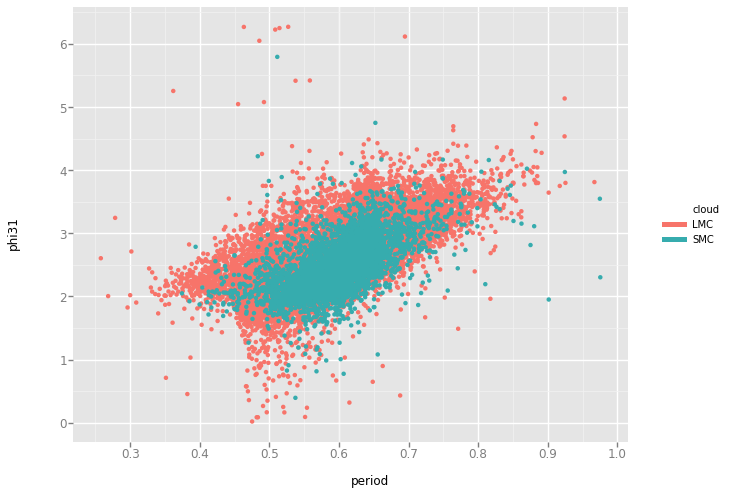

<ggplot: (8741449911073)>

In [42]:
from ggplot import *

smc = data[["period", "amplitude_Iband", "phi31"]]
smc["cloud"] = ["SMC"] * smc.shape[0]
lmc = lmc_data[["period", "amplitude_Iband", "phi31"]]
lmc["cloud"] = ["LMC"] * lmc.shape[0]
all_data = pd.concat([smc, lmc])
ggplot(aes(x = "period", y = "phi31", color = "cloud"), data = all_data) +\
    geom_point()